In [1]:
import numpy as np
import pandas as pd
import astropy as ap
import matplotlib.pyplot as plt
from pyvo import registry
from mocpy import MOC
from astropy.coordinates import SkyCoord
from ipyaladin import Aladin
import matplotlib.pyplot as plt
import pandas as pd
from scipy.signal import find_peaks
from scipy.ndimage import gaussian_filter1d

In [2]:
import pandas as pd

def nm_to_cm1(df, wavelength_col, new_col='wave'):
    df[new_col] = 1e7 / df[wavelength_col]
    return df

def vacuum_to_air(wavelength_vac_nm):
    """
    Convierte lambda (vacío, nm) a lambda (aire) usando la fórmula de Edlén (1966).
    Ref: https://www.astro.uu.se/valdwiki/Air-to-vacuum%20conversion
    """
    s = 1e4 / wavelength_vac_nm  # wavenumber in 1/μm
    n = 1 + 0.00008336624212083 + 0.02408926869968 / (130.1065924522 - s**2) + 0.0001599740894897 / (38.92568793293 - s**2)
    return wavelength_vac_nm / n


In [3]:
peaks = pd.read_csv("./lineas_hierro.csv")
nm_to_cm1(peaks, "lambda")
peaks['lambda_air'] = [vacuum_to_air(x) for x in peaks['lambda']]
peaks

,lambda,wave,lambda_air
0,4060.8601,2462.532506,4059.713491
1,4068.4198,2457.956772,4067.271213
2,4080.9899,2450.385873,4079.838024
3,4086.1573,2447.287088,4085.004071
4,4088.2476,2446.035803,4087.093824
...,...,...,...
617,10426.6020,959.085232,10423.745435
618,10535.1220,949.205904,10532.236012
619,10558.5430,947.100372,10555.650662
620,10580.0390,945.176100,10577.140833


In [4]:
CATALOGUE = "J/A+A/587/A65"
catalogue_ivoid = f"ivo://CDS.VizieR/{CATALOGUE}"
voresource = registry.search(ivoid=catalogue_ivoid)[0]

In [5]:
tables = voresource.get_tables()
print(f"In this catalogue, we have {len(tables)} tables.")
for table_name, table in tables.items():
    print(f"{table_name}: {table.description}")

In this catalogue, we have 3 tables.
J/A+A/587/A65/tablea1: Absolute convective blueshift of FeI lines measured from the IAG atlas
J/A+A/587/A65/spnir: NIR atlas 1000-2300nm
J/A+A/587/A65/spvis: VIS atlas 405-1065nm


In [6]:
table_name = list(tables.keys())[1]

# execute a synchronous ADQL query
tap_service = voresource.get_service("tap")
variables = tap_service.search(f'''
                                        SELECT
                                            *
                                        FROM
                                            "{table_name}"
                                        ''')
variables

<DALResultsTable length=3001260>
 recno       Wave         nFlux         rFlux    
            cm**-1                               
 int32     float64       float64       float64   
------- ------------- -------------- ------------
      1 4347.82178977 0.922568929035 0.0155350892
    ...           ...            ...          ...
3001259 9999.99684921 0.997236956508 0.1348003894
3001260 9999.99873247 0.996949333095 0.1347614676

In [7]:
waves = np.array(variables.getcolumn("Wave"))
fluxes = np.array(variables.getcolumn("nFlux"))

In [8]:
lambda_array = np.array(peaks["lambda_air"])  # tu lista de puntos

# Verificar cuáles están en los datos (con cierta tolerancia)
tolerancia = 0.1  # Angstroms de tolerancia

estan_en_datos = []
no_estan_en_datos = []

for punto in lambda_array:
    # Buscar el punto más cercano en los datos
    diferencias = np.abs(waves - punto)
    indice_min = np.argmin(diferencias)
    
    if diferencias[indice_min] <= tolerancia:
        estan_en_datos.append(indice_min)
    else:
        no_estan_en_datos.append(punto)

print(f"Total puntos en lista lambda: {len(lambda_array)}")
print(f"Puntos encontrados en datos: {len(estan_en_datos)}")
print(f"Puntos NO encontrados en datos: {len(no_estan_en_datos)}")

Total puntos en lista lambda: 622
Puntos encontrados en datos: 535
Puntos NO encontrados en datos: 87


In [9]:
waves_inside = np.array([waves[x] for x in estan_en_datos])
fluxes_inside = np.array([fluxes[x] for x in estan_en_datos])
waves_inside_ind = np.array([x for x in estan_en_datos])
fluxes_inside_ind = np.array([x for x in estan_en_datos])

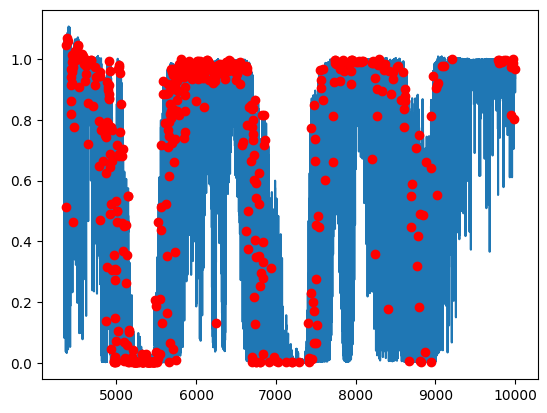

In [10]:
plt.plot(waves, fluxes)
plt.plot(waves_inside, fluxes_inside, 'ro')

In [11]:
# Versión más eficiente usando list comprehensions
waves_ranges = []
fluxes_ranges = []

for idx in estan_en_datos:
    start = max(0, idx - 10)
    end = min(len(waves), idx + 11)
    waves_ranges.append(waves[start:end])
    fluxes_ranges.append(fluxes[start:end])

# Graficar solo algunos ejemplos (primeros 5)
num_to_plot = min(622, len(waves_ranges))
fig, axes = plt.subplots(num_to_plot, 1, figsize=(12, 4*num_to_plot))

if num_to_plot == 1:
    axes = [axes]

for i, (ax, wave_range, flux_range) in enumerate(zip(axes, waves_ranges[:num_to_plot], fluxes_ranges[:num_to_plot])):
    ax.plot(wave_range, flux_range, 'b-', linewidth=1.5)
    
    # Marcar el punto central
    center_idx = len(wave_range) // 2
    ax.scatter(wave_range[center_idx], flux_range[center_idx], 
               color='red', s=80, zorder=5, edgecolors='black')
    
    ax.set_xlabel('Wavelength', fontsize=11)
    ax.set_ylabel('Flux', fontsize=11)
    ax.set_title(f'Punto {i+1}: Índice original {estan_en_datos[i]}', fontsize=12)
    ax.grid(True, alpha=0.3)
    ax.axvline(x=wave_range[center_idx], color='r', linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

Procesando 535 puntos...
Búsqueda de mínimos locales completada


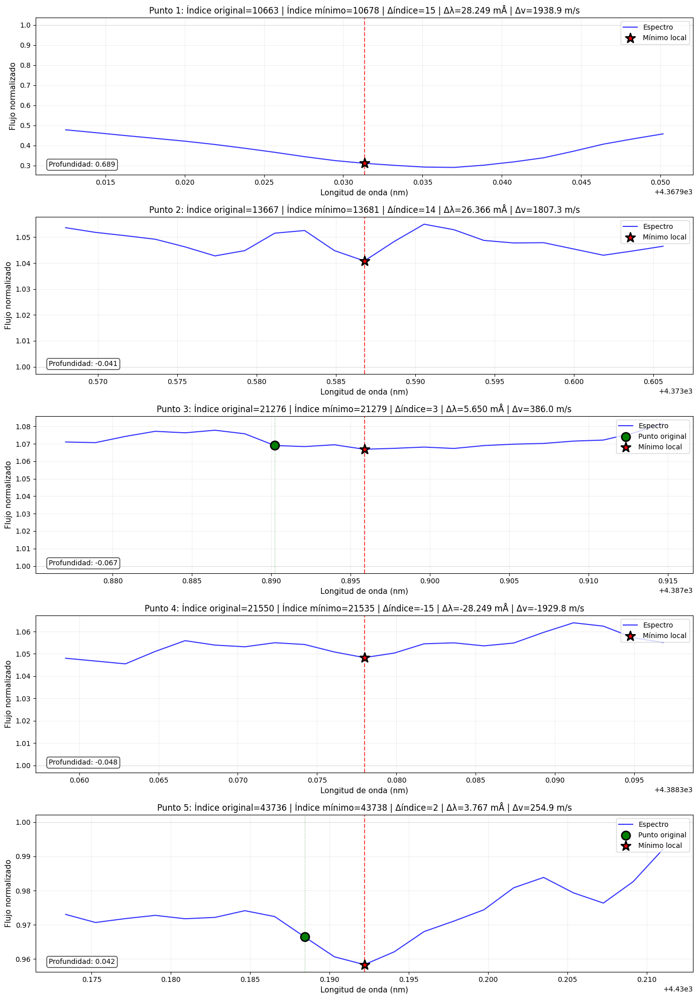


RESUMEN DE TODOS LOS PUNTOS ANALIZADOS
#   Idx_orig Idx_min  Δidx   λ_orig       λ_min        Δλ(mÅ)     Flux_orig  Flux_min   Prof.
----------------------------------------------------------------------------------------------------
1   10663    10678    15     4367.90308   4367.93133   28.249     0.515      0.311      0.689
2   13667    13681    14     4373.56042   4373.58679   26.366     1.046      1.041      -0.041
3   21276    21279    3      4387.89021   4387.89586   5.650      1.069      1.067      -0.067
4   21550    21535    -15    4388.40623   4388.37798   -28.249    1.061      1.048      -0.048
5   43736    43738    2      4430.18843   4430.19219   3.767      0.966      0.958      0.042
6   43962    43976    14     4430.61405   4430.64041   26.366     0.861      0.820      0.180
7   44999    45014    15     4432.56700   4432.59524   28.249     0.820      0.776      0.224
8   45644    45642    -2     4433.78170   4433.77794   -3.767     0.941      0.936      0.064
9   48066 

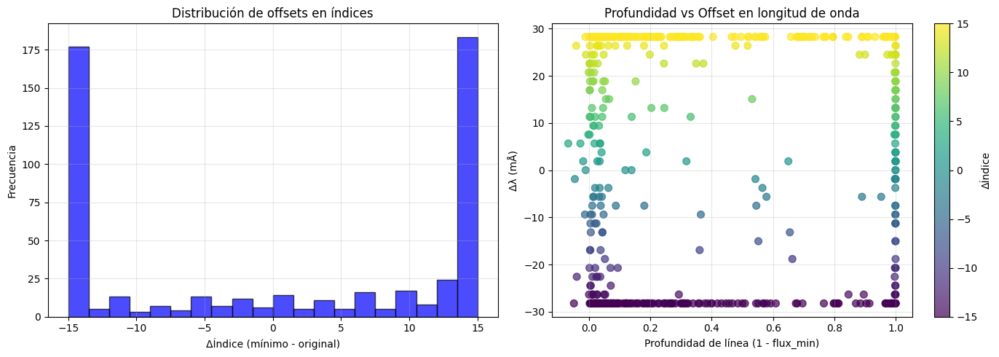


Análisis completado:
• Número total de puntos procesados: 535
• Rango medio de offsets en índice: 12.37 ± 13.09
• Rango medio de offsets en λ: 23.300 ± 24.652 mÅ
• Profundidad media de líneas: 0.360 ± 0.385


In [12]:


def find_local_minima_around_point(waves, fluxes, center_idx, search_radius=15, smooth_sigma=1):
    """
    Encuentra el mínimo local más cercano a un punto dado.
    
    Parameters:
    -----------
    waves : array
        Array de longitudes de onda
    fluxes : array
        Array de flujos normalizados
    center_idx : int
        Índice del punto central original
    search_radius : int
        Radio de búsqueda en puntos alrededor del centro
    smooth_sigma : float
        Parámetro de suavizado Gaussiano para eliminar ruido
        
    Returns:
    --------
    min_idx : int
        Índice del mínimo local encontrado
    min_flux : float
        Valor de flujo en el mínimo
    min_wave : float
        Longitud de onda del mínimo
    """
    # Definir límites de búsqueda
    start_idx = max(0, center_idx - search_radius)
    end_idx = min(len(waves), center_idx + search_radius + 1)
    
    # Extraer región de búsqueda
    search_waves = waves[start_idx:end_idx]
    search_fluxes = fluxes[start_idx:end_idx]
    
    # Suavizar ligeramente para eliminar ruido y encontrar mínimos reales
    if len(search_fluxes) > 5:
        smoothed_fluxes = gaussian_filter1d(search_fluxes, sigma=smooth_sigma)
    else:
        smoothed_fluxes = search_fluxes
    
    # Invertir flujo para buscar máximos (find_peaks busca máximos)
    # En flujo invertido, los mínimos se convierten en máximos
    inverted_flux = 1.0 - smoothed_fluxes
    
    # Buscar picos en el flujo invertido
    peaks, properties = find_peaks(
        inverted_flux,
        height=0.1,        # Profundidad mínima (10% de absorción)
        prominence=0.05,   # Prominencia mínima
        distance=3,        # Distancia mínima entre picos
        width=1           # Ancho mínimo
    )
    
    # Si encontramos picos (mínimos en el flujo original)
    if len(peaks) > 0:
        # Calcular distancias desde el centro original (en índice local)
        local_center_idx = center_idx - start_idx
        distances = np.abs(peaks - local_center_idx)
        
        # Tomar el mínimo más cercano
        nearest_min_idx_local = peaks[np.argmin(distances)]
        
        # Convertir a índice global
        min_idx = start_idx + nearest_min_idx_local
    else:
        # Si no encontramos mínimos, usar el punto con flujo más bajo
        min_idx_local = np.argmin(search_fluxes)
        min_idx = start_idx + min_idx_local
    
    return min_idx, fluxes[min_idx], waves[min_idx]

# Versión optimizada usando list comprehensions y búsqueda de mínimos locales
waves_ranges = []
fluxes_ranges = []
original_points = []
local_min_points = []

print(f"Procesando {len(estan_en_datos)} puntos...")

for idx in estan_en_datos:
    # Encontrar mínimo local más cercano
    min_idx, min_flux, min_wave = find_local_minima_around_point(
        waves, fluxes, idx, search_radius=15, smooth_sigma=1
    )
    
    # Definir rango de trazado alrededor del mínimo (no del punto original)
    plot_radius = 10  # Puntos a cada lado del mínimo
    start = max(0, min_idx - plot_radius)
    end = min(len(waves), min_idx + plot_radius + 1)
    
    waves_ranges.append(waves[start:end])
    fluxes_ranges.append(fluxes[start:end])
    original_points.append((idx, waves[idx], fluxes[idx]))
    local_min_points.append((min_idx, min_wave, min_flux))

print("Búsqueda de mínimos locales completada")

# Crear gráficas
num_to_plot = min(5, len(waves_ranges))  # Mostrar solo primeros 5 para visualización
fig, axes = plt.subplots(num_to_plot, 1, figsize=(14, 4*num_to_plot), sharex=False)

if num_to_plot == 1:
    axes = [axes]

for i, (ax, wave_range, flux_range, orig_pt, min_pt) in enumerate(zip(
    axes, waves_ranges[:num_to_plot], fluxes_ranges[:num_to_plot],
    original_points[:num_to_plot], local_min_points[:num_to_plot]
)):
    # Trazar el espectro
    ax.plot(wave_range, flux_range, 'b-', linewidth=1.5, alpha=0.8, label='Espectro')
    
    # Marcar el punto original (verde)
    orig_idx, orig_wave, orig_flux = orig_pt
    # Verificar si el punto original está dentro del rango trazado
    if wave_range[0] <= orig_wave <= wave_range[-1]:
        ax.scatter(orig_wave, orig_flux, 
                  color='green', s=150, zorder=10, edgecolors='black', linewidth=2,
                  marker='o', label='Punto original')
        ax.axvline(x=orig_wave, color='green', linestyle=':', alpha=0.5, linewidth=1)
    
    # Marcar el mínimo local encontrado (rojo)
    min_idx, min_wave, min_flux = min_pt
    ax.scatter(min_wave, min_flux, 
              color='red', s=200, zorder=10, edgecolors='black', linewidth=2,
              marker='*', label='Mínimo local')
    ax.axvline(x=min_wave, color='red', linestyle='--', alpha=0.7, linewidth=1.5)
    
    # Añadir línea de continuo (flujo=1)
    ax.axhline(y=1.0, color='gray', linestyle='-', alpha=0.3, linewidth=0.5)
    
    # Calcular y mostrar métricas
    offset_pixels = min_idx - orig_idx
    offset_wave = min_wave - orig_wave
    
    # Calcular offset en velocidad (m/s)
    c = 299792458  # m/s
    if orig_wave > 0:
        velocity_offset = (offset_wave / orig_wave) * c
        velocity_text = f'{velocity_offset:.1f} m/s'
    else:
        velocity_offset = 0
        velocity_text = 'N/A'
    
    # Información en el título
    ax.set_title(
        f'Punto {i+1}: Índice original={orig_idx} | '
        f'Índice mínimo={min_idx} | Δíndice={offset_pixels} | '
        f'Δλ={offset_wave*1000:.3f} mÅ | Δv={velocity_text}',
        fontsize=12
    )
    
    ax.set_xlabel('Longitud de onda (nm)', fontsize=11)
    ax.set_ylabel('Flujo normalizado', fontsize=11)
    ax.grid(True, alpha=0.2)
    ax.legend(loc='upper right')
    
    # Añadir anotación con profundidad de línea
    line_depth = 1 - min_flux
    ax.annotate(f'Profundidad: {line_depth:.3f}', 
                xy=(0.02, 0.05), xycoords='axes fraction',
                fontsize=10, bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))

plt.tight_layout()
plt.show()

# Mostrar resumen de todos los puntos
print("\n" + "="*80)
print("RESUMEN DE TODOS LOS PUNTOS ANALIZADOS")
print("="*80)
print(f"{'#':<3} {'Idx_orig':<8} {'Idx_min':<8} {'Δidx':<6} {'λ_orig':<12} {'λ_min':<12} {'Δλ(mÅ)':<10} {'Flux_orig':<10} {'Flux_min':<10} {'Prof.'}")
print("-"*100)

for i in range(len(original_points)):
    orig_idx, orig_wave, orig_flux = original_points[i]
    min_idx, min_wave, min_flux = local_min_points[i]
    
    offset_idx = min_idx - orig_idx
    offset_wave_mA = (min_wave - orig_wave) * 1000  # en mÅ
    depth = 1 - min_flux
    
    print(f"{i+1:<3} {orig_idx:<8} {min_idx:<8} {offset_idx:<6} "
          f"{orig_wave:<12.5f} {min_wave:<12.5f} {offset_wave_mA:<10.3f} "
          f"{orig_flux:<10.3f} {min_flux:<10.3f} {depth:.3f}")

# Crear gráfica de resumen de offsets
fig2, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

# Histograma de offsets en píxeles
offsets_idx = [min_pt[0] - orig_pt[0] for orig_pt, min_pt in zip(original_points, local_min_points)]
ax1.hist(offsets_idx, bins=20, alpha=0.7, color='blue', edgecolor='black')
ax1.set_xlabel('ΔÍndice (mínimo - original)')
ax1.set_ylabel('Frecuencia')
ax1.set_title('Distribución de offsets en índices')
ax1.grid(True, alpha=0.3)

# Gráfica de dispersión: profundidad vs offset
depths = [1 - min_pt[2] for min_pt in local_min_points]
offsets_wave = [(min_pt[1] - orig_pt[1])*1000 for orig_pt, min_pt in zip(original_points, local_min_points)]

scatter = ax2.scatter(depths, offsets_wave, c=offsets_idx, cmap='viridis', alpha=0.7, s=50)
ax2.set_xlabel('Profundidad de línea (1 - flux_min)')
ax2.set_ylabel('Δλ (mÅ)')
ax2.set_title('Profundidad vs Offset en longitud de onda')
ax2.grid(True, alpha=0.3)

# Añadir barra de color para offsets en índices
cbar = plt.colorbar(scatter, ax=ax2)
cbar.set_label('ΔÍndice')

plt.tight_layout()
plt.show()

print(f"\nAnálisis completado:")
print(f"• Número total de puntos procesados: {len(estan_en_datos)}")
print(f"• Rango medio de offsets en índice: {np.mean(np.abs(offsets_idx)):.2f} ± {np.std(offsets_idx):.2f}")
print(f"• Rango medio de offsets en λ: {np.mean(np.abs(offsets_wave)):.3f} ± {np.std(offsets_wave):.3f} mÅ")
print(f"• Profundidad media de líneas: {np.mean(depths):.3f} ± {np.std(depths):.3f}")

In [13]:
local_min_points

[(np.int64(10678), np.float64(4367.93133226), np.float64(0.311453505069)),
 (np.int64(13681), np.float64(4373.58678798), np.float64(1.04082536183)),
 (np.int64(21279), np.float64(4387.89586307), np.float64(1.06685837406)),
 (np.int64(21535), np.float64(4388.37797984), np.float64(1.04831419951)),
 (np.int64(43738), np.float64(4430.19219336), np.float64(0.958379553861)),
 (np.int64(43976), np.float64(4430.64041129), np.float64(0.820138243854)),
 (np.int64(45014), np.float64(4432.59524413), np.float64(0.775733905891)),
 (np.int64(45642), np.float64(4433.77793684), np.float64(0.935967942659)),
 (np.int64(48081), np.float64(4438.37122904), np.float64(0.888405747144)),
 (np.int64(50184), np.float64(4442.33174298), np.float64(0.911837663266)),
 (np.int64(50463), np.float64(4442.85717493), np.float64(0.936421708121)),
 (np.int64(51860), np.float64(4445.48810121), np.float64(0.996812955397)),
 (np.int64(52718), np.float64(4447.1039457), np.float64(0.972732031252)),
 (np.int64(54409), np.float64

In [42]:
import numpy as np
from typing import List, Tuple, Iterable
from scipy.signal import find_peaks

class SpectralPeak():
    """
    Clase CORREGIDA para líneas de absorción espectrales.
    Ahora busca MÍNIMOS (valles) en lugar de máximos.
    """
    def __init__(self,
                 center,
                 complete=False,
                 symmetric: Tuple[bool, str] | None = None,
                 adyacents_left: list | None = None,
                 adyacents_right: list | None = None,
                 total_area=0):
        self.center = center
        self.complete = complete
        self.symmetric = (True, "both") if symmetric is None else symmetric
        self.adyacents_left = [] if adyacents_left is None else adyacents_left
        self.adyacents_right = [] if adyacents_right is None else adyacents_right
        self.total_area = total_area
        self.is_absorption_line = True  # Nueva bandera para líneas de absorción
    
    def __str__(self) -> str:
        return (f"SpectralPeak(Center: {self.center}, Complete: {self.complete}, "
                f"Symmetric: {self.symmetric}, Left: {self.adyacents_left}, "
                f"Right: {self.adyacents_right}, Area: {self.total_area:.4f})")

    def __repr__(self) -> str:
        return self.__str__()
    
    def checkpeak(self, dependent, independent):
        """
        VERIFICACIÓN CORREGIDA para líneas de absorción (mínimos).
        
        Para líneas de absorción espectrales:
        - El flujo en el centro debe ser MENOR que los vecinos
        - Esto corresponde a un VALLE en el espectro
        """
        center_idx = self.center
        
        if center_idx <= 0 or center_idx >= len(dependent) - 1:
            print(f"Error: Centro en posición {center_idx} no tiene vecinos adyacentes")
            return False
        
        prev_idx = center_idx - 1
        next_idx = center_idx + 1
        
        prev_value = dependent[prev_idx]
        center_value = dependent[center_idx]
        next_value = dependent[next_idx]
        
        # CORRECCIÓN CRÍTICA: Para líneas de absorción, buscamos MÍNIMOS
        # Original (para picos/máximos): center_value > prev_value and center_value > next_value
        # CORREGIDO (para valles/mínimos): center_value < prev_value and center_value < next_value
        is_absorption_valley = (center_value < prev_value) and (center_value < next_value)
        
        # También verificamos que sea significativo (no ruido)
        # El continuo está en ~1.0 para espectros normalizados
        MIN_DEPTH = 0.01  # Profundidad mínima del 1%
        depth = 1.0 - center_value
        is_significant = depth > MIN_DEPTH
        
        # Información de diagnóstico
        prev_pos = independent[prev_idx]
        center_pos = independent[center_idx]
        next_pos = independent[next_idx]
        
        left_slope = center_value - prev_value  # Debería ser negativa en el lado izquierdo de un valle
        right_slope = next_value - center_value  # Debería ser positiva en el lado derecho de un valle
        
        print(f"{prev_value:.6f} {center_value:.6f} {next_value:.6f}, {is_absorption_valley}")
        
        return is_absorption_valley and is_significant

    def is_complete(self) -> bool:
        return self.complete

    def calculate_area(self, dependent, independent):
        """
        Cálculo CORREGIDO del ancho equivalente para líneas de absorción.
        
        Para líneas de absorción:
        - El continuo está en ~1.0 (espectro normalizado)
        - El área = ∫ (1 - flujo) dλ
        - Esto da el ancho equivalente en unidades de longitud de onda
        """
        def calculate_segment_area(indices, is_left_side=False):
            """
            Calcula área para un segmento de línea.
            Para líneas de absorción: altura = (continuo - flujo)
            """
            area = 0.0
            continuum = 1.0  # Continuo normalizado
            
            for i in range(1, len(indices)):
                x1 = independent[indices[i-1]]
                x2 = independent[indices[i]]
                y1 = dependent[indices[i-1]]
                y2 = dependent[indices[i]]
                
                # Área del trapecio: base * altura promedio
                # Altura = continuo - flujo
                height1 = continuum - y1
                height2 = continuum - y2
                area += (x2 - x1) * (height1 + height2) / 2.0
            return area

        if self.symmetric[0]:
            # Línea simétrica: usar ambos lados
            left_indices = list(reversed(self.adyacents_left)) + [self.center]
            right_indices = [self.center] + self.adyacents_right
        
            left_area = calculate_segment_area(left_indices, is_left_side=True)
            right_area = calculate_segment_area(right_indices, is_left_side=False)
            self.total_area = left_area + right_area
        else:
            # Línea asimétrica: extrapolar
            problematic_side = self.symmetric[1]
        
            if problematic_side == "left":
                right_indices = [self.center] + self.adyacents_right
                right_area = calculate_segment_area(right_indices, is_left_side=False)
                self.total_area = right_area * 2  # Asume simetría
            else:
                left_indices = list(reversed(self.adyacents_left)) + [self.center]
                left_area = calculate_segment_area(left_indices, is_left_side=True)
                self.total_area = left_area * 2  # Asume simetría

    def _calculate_slope(self, p1: Tuple[float, float], p2: Tuple[float, float]) -> float:
        """Calcula pendiente entre dos puntos."""
        x1, y1 = p1
        x2, y2 = p2
        return (y2 - y1) / (x2 - x1)

    def expand(self, heights, positions):
        """
        Expansión CORREGIDA para líneas de absorción.
        
        Para líneas de absorción:
        - Nos expandimos mientras el flujo esté por debajo del continuo (~1.0)
        - Detenemos cuando el flujo se acerca al continuo
        """
        if self.complete:
            return

        # PARÁMETROS CORREGIDOS para absorción
        TOLERANCE = 0.001  # Pendiente mínima para detección
        CONTINUUM_THRESHOLD = 0.995  # Consideramos continuo cuando flujo > 0.995
        MAX_EXPANSION = 50  # Límite máximo de expansión

        def should_expand_left(current_idx, next_idx):
            """Decide si debemos expandir hacia la izquierda para líneas de absorción."""
            if next_idx < 0:
                return False, "fuera_de_limites"
            
            current_flux = heights[current_idx]
            next_flux = heights[next_idx]
            
            # 1. ¿El siguiente punto está en el continuo?
            if next_flux >= CONTINUUM_THRESHOLD:
                return False, "alcanzado_continuo"
            
            # 2. Para absorción: expandimos mientras el flujo aumente hacia la izquierda
            # (es decir, mientras nos alejamos del centro, el flujo debería aumentar)
            slope = next_flux - current_flux
            if slope > 0:  # Pendiente positiva: flujo aumenta alejándose del centro
                return True, "en_valle"
            elif abs(slope) < TOLERANCE:  # Pendiente casi cero
                return False, "pendiente_cero"
            else:  # Pendiente negativa: dirección incorrecta
                return False, "fuera_del_valle"
        
        def should_expand_right(current_idx, next_idx):
            """Decide si debemos expandir hacia la derecha para líneas de absorción."""
            if next_idx >= len(heights):
                return False, "fuera_de_limites"
            
            current_flux = heights[current_idx]
            next_flux = heights[next_idx]
            
            # 1. ¿El siguiente punto está en el continuo?
            if next_flux >= CONTINUUM_THRESHOLD:
                return False, "alcanzado_continuo"
            
            # 2. Para absorción: expandimos mientras el flujo aumente hacia la derecha
            slope = next_flux - current_flux
            if slope > 0:  # Pendiente positiva: flujo aumenta alejándose del centro
                return True, "en_valle"
            elif abs(slope) < TOLERANCE:
                return False, "pendiente_cero"
            else:
                return False, "fuera_del_valle"

        # Expansión hacia la izquierda
        if not self.symmetric[0] and self.symmetric[1] == "right":
            # Solo expandir hacia la izquierda si es necesario
            if len(self.adyacents_left) == 0:
                current_idx = self.center
            else:
                current_idx = self.adyacents_left[-1]
            
            next_idx = current_idx - 1
            
            expand_left, reason = should_expand_left(current_idx, next_idx)
            
            if expand_left and len(self.adyacents_left) < MAX_EXPANSION:
                self.adyacents_left.append(next_idx)
            elif not expand_left and reason != "fuera_de_limites":
                if self.symmetric[0]:
                    self.symmetric = (False, "left")
                else:
                    self.complete = True
        
        # Expansión hacia la derecha
        if not self.symmetric[0] and self.symmetric[1] == "left":
            # Solo expandir hacia la derecha si es necesario
            if len(self.adyacents_right) == 0:
                current_idx = self.center
            else:
                current_idx = self.adyacents_right[-1]
            
            next_idx = current_idx + 1
            
            expand_right, reason = should_expand_right(current_idx, next_idx)
            
            if expand_right and len(self.adyacents_right) < MAX_EXPANSION:
                self.adyacents_right.append(next_idx)
            elif not expand_right and reason != "fuera_de_limites":
                if self.symmetric[0]:
                    self.symmetric = (False, "right")
                else:
                    self.complete = True
        
        # Expansión simétrica (ambos lados)
        if self.symmetric[0]:
            # Izquierda
            if len(self.adyacents_left) == 0:
                left_current = self.center
            else:
                left_current = self.adyacents_left[-1]
            
            left_next = left_current - 1
            expand_left, left_reason = should_expand_left(left_current, left_next)
            
            # Derecha
            if len(self.adyacents_right) == 0:
                right_current = self.center
            else:
                right_current = self.adyacents_right[-1]
            
            right_next = right_current + 1
            expand_right, right_reason = should_expand_right(right_current, right_next)
            
            # Expandir ambos si es posible
            if expand_left and expand_right and \
               len(self.adyacents_left) < MAX_EXPANSION and \
               len(self.adyacents_right) < MAX_EXPANSION:
                self.adyacents_left.append(left_next)
                self.adyacents_right.append(right_next)
            elif expand_left and not expand_right:
                # Solo expandir izquierda, marcar como asimétrica derecha
                if len(self.adyacents_left) < MAX_EXPANSION:
                    self.adyacents_left.append(left_next)
                self.symmetric = (False, "right")
            elif not expand_left and expand_right:
                # Solo expandir derecha, marcar como asimétrica izquierda
                if len(self.adyacents_right) < MAX_EXPANSION:
                    self.adyacents_right.append(right_next)
                self.symmetric = (False, "left")
            else:
                # Ningún lado puede expandir más
                self.complete = True
        
        # Verificar si hemos alcanzado los límites
        if (len(self.adyacents_left) >= MAX_EXPANSION or 
            len(self.adyacents_right) >= MAX_EXPANSION):
            self.complete = True


def create_peaks(iter: Iterable[int | float]) -> List[SpectralPeak]:
    """Crea objetos SpectralPeak a partir de índices."""
    return [SpectralPeak(int(item)) for item in iter]


class ExplicitPeaksMethod():
    """
    Método CORREGIDO para análisis de líneas de absorción espectrales.
    """
    def __init__(self, master=None, catalog=None, table=None, type=None):
        self.master = master
        self.catalog = catalog
        self.table = table
        self.type = type
        self.continuum_threshold = 0.995  # Umbral para líneas de absorción
        self.min_depth = 0.01  # Profundidad mínima
        print("Inicializado (modo absorción)")

    def calculate(self, peaks_ind, dependent, independent):
        """
        Análisis CORREGIDO para líneas de absorción.
        """
        # Crear objetos SpectralPeak (corregidos para absorción)
        peaks = create_peaks(peaks_ind)
        
        # Verificar cada línea
        valid_peaks = []
        for peak in peaks:
            is_valid = peak.checkpeak(dependent, independent)
            if is_valid:
                valid_peaks.append(peak)
            else:
                print(f"Advertencia: Punto en índice {peak.center} no es una línea de absorción válida")
        
        # Expandir y calcular áreas solo para líneas válidas
        max_expands = 1000 * len(valid_peaks)
        
        while not all(p.is_complete() for p in valid_peaks) and max_expands > 0:
            for peak in valid_peaks:
                peak.expand(dependent, independent)
            max_expands -= 1
        
        # Calcular áreas (anchos equivalentes)
        for peak in valid_peaks:
            peak.calculate_area(dependent, independent)
            wavelength = independent[peak.center]
            print(f"Línea en λ={wavelength:.5f} nm: EW={peak.total_area*1000:.1f} mÅ")
        
        # Generar imagen si está configurado
        if hasattr(self, 'generate_image') and self.generate_image.get():
            self.generate_image_aux(independent, dependent, valid_peaks)
        
        # Escribir resultados
        if hasattr(self, 'write_peaks_to_file'):
            self.write_peaks_to_file(valid_peaks, independent)
        
        print(f"\nResumen: {len(valid_peaks)} líneas de absorción analizadas")
        print(valid_peaks)
        
        return valid_peaks

    def generate_image_aux(self, independent, dependent, peaks):
        """Genera gráfica para líneas de absorción."""
        import matplotlib.pyplot as plt
        
        fig, ax = plt.subplots(figsize=(12, 6))
        
        # Graficar espectro
        ax.plot(independent, dependent, 'b-', label='Espectro', alpha=0.7, linewidth=1)
        
        # Graficar umbral del continuo
        ax.axhline(y=self.continuum_threshold, color='g', linestyle='--', 
                   alpha=0.5, label='Umbral continuo')
        
        # Graficar líneas y sus áreas
        for i, peak in enumerate(peaks):
            # Obtener todos los índices de la línea
            indices = peak.adyacents_left + [peak.center] + peak.adyacents_right
            indices.sort()
            
            x_peak = [independent[i] for i in indices]
            y_peak = [dependent[i] for i in indices]
            
            # Sombrear área del ancho equivalente (continuo - flujo)
            continuum_line = [self.continuum_threshold] * len(x_peak)
            ax.fill_between(x_peak, y_peak, continuum_line, 
                          color='pink', alpha=0.4, 
                          label=f'EW={peak.total_area*1000:.1f} mÅ' if i==0 else "")
            
            # Marcar centro
            ax.scatter(independent[peak.center], dependent[peak.center], 
                      color='red', s=80, zorder=5, marker='x')
        
        ax.set_xlabel('Longitud de onda (nm)')
        ax.set_ylabel('Flujo normalizado')
        ax.set_title(f'{len(peaks)} líneas de absorción analizadas')
        ax.grid(True, alpha=0.3)
        ax.legend(loc='upper right')
        
        plt.tight_layout()
        plt.savefig("results_absorption.png")
        plt.show()

    def write_peaks_to_file(self, peaks, independent, file_name="results_absorption.csv"):
        """Escribe resultados en formato CSV."""
        with open(file_name, "w") as file:
            file.write("Wave_center(nm),Flux_center,EW(mÅ),Depth,N_points\n")
            for peak in peaks:
                wave_center = independent[peak.center]
                flux_center = dependent[peak.center]
                depth = 1 - flux_center
                n_points = len(peak.adyacents_left) + len(peak.adyacents_right) + 1
                file.write(f"{wave_center:.5f},{flux_center:.5f},{peak.total_area*1000:.2f},{depth:.4f},{n_points}\n")

In [43]:
# 1. Encontrar mínimos locales (como ya lo haces)
local_min_points_ind = []
for ind, _, _ in local_min_points:
    local_min_points_ind.append(ind)

# 2. Usar la clase CORREGIDA
calculator = ExplicitPeaksMethod()
results = calculator.calculate(local_min_points_ind, waves, fluxes)

Inicializado (modo absorción)
4367.929449 4367.931332 4367.933216, False
Advertencia: Punto en índice 10678 no es una línea de absorción válida
4373.584905 4373.586788 4373.588671, False
Advertencia: Punto en índice 13681 no es una línea de absorción válida
4387.893980 4387.895863 4387.897746, False
Advertencia: Punto en índice 21279 no es una línea de absorción válida
4388.376097 4388.377980 4388.379863, False
Advertencia: Punto en índice 21535 no es una línea de absorción válida
4430.190310 4430.192193 4430.194077, False
Advertencia: Punto en índice 43738 no es una línea de absorción válida
4430.638528 4430.640411 4430.642295, False
Advertencia: Punto en índice 43976 no es una línea de absorción válida
4432.593361 4432.595244 4432.597127, False
Advertencia: Punto en índice 45014 no es una línea de absorción válida
4433.776054 4433.777937 4433.779820, False
Advertencia: Punto en índice 45642 no es una línea de absorción válida
4438.369346 4438.371229 4438.373112, False
Advertencia: Pu